# Ferromagnetism

A project exploring the Curie temperature and the Ising model for Ferromagnetism.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

We define a few functions to help simplify the code later on. The function `createGrid`, creates our electron lattice. The default is for a 50 by 50 grid, but other values can be chosen. The `mutate` function is where the actual magic happens. It takes a grid (i.e. a 2d numpy array) representing an electron lattice and the temperature that the grid is at (not quite true, since the argument `T` really represents the inverse of the thermodynamic beta or the coldness of the system defined as $\beta = \frac{1}{k_B T}$ where $k_B$ is the Boltzmann constant and $T$ is the temperature of the system in Kelvin. It also takes in an argument specifying the number of iterations to be carried out.

In [2]:
def creategrid(n=50, m=50):
    """Returns a n by m array of random integer spins."""
    return np.random.choice(np.array([-1, 1]), (n, m))


def mutate(sigma, T, iterations):
    """Mutates one electron spin in a 2D electron array using the Ising model.

    Keyargs:
    sigma      : 2D numpy array of the electron configuration to be mutated.
    T          : Temperatuyre of the configuration.
    iterations : Number of mutations to be carried out in one call.

    Returns:
    Mutated electron configuration as a 2D numpy array.
    """
    n, m = np.shape(sigma)

    for _ in range(iterations):
        # Choosing a random electron to be mutated
        ranrow, rancol = np.random.randint(0, n), np.random.randint(0, m)

        # Computing the local change in energy dH = Hnew - Hinitial
        dH = -2 * sigma[ranrow, rancol] * (sigma[(ranrow + 1) % n, rancol]
                                           + sigma[ranrow - 1, rancol]
                                           + sigma[ranrow, (rancol + 1) % m]
                                           + sigma[ranrow, rancol - 1])

        # If dH is > 0, Hnew is samller than Hinitial
        if dH > 0:
            sigma[ranrow, rancol] *= -1
        else:
            # Probability derived from Ising model
            P = np.exp((dH / T))
            ranflt = np.random.random()
            if ranflt <= P:
                sigma[ranrow, rancol] *= -1
            else:
                pass
    return sigma

Here we make a list of all the temperatures of interest.

In [3]:
Temperatures = [0.01, 0.1, 1, 2, 3, 4, 5, 10, 100]

To find the Curie temperature we are looking for the temperature where the magnetic moment changes very abruptly. To do so we run the Ising simulation five times for each temperature at 600000 iterations for each run. For each of the five runs we only keep the maximum magnetic moment. For simplicity, we set $\mu = 1$. The end result is a list containing the maximum magnetic moments found over five runs for each temperature.

In [4]:
maxmoments = []

for T in Temperatures:
    moments = []
    for _ in range(5):
        sigma = creategrid()
        moments.append(np.abs(np.sum(mutate(sigma, T, 600000))))
    maxmoments.append(max(moments))

We now plot the magnetic moments to visually the Curie temperature.

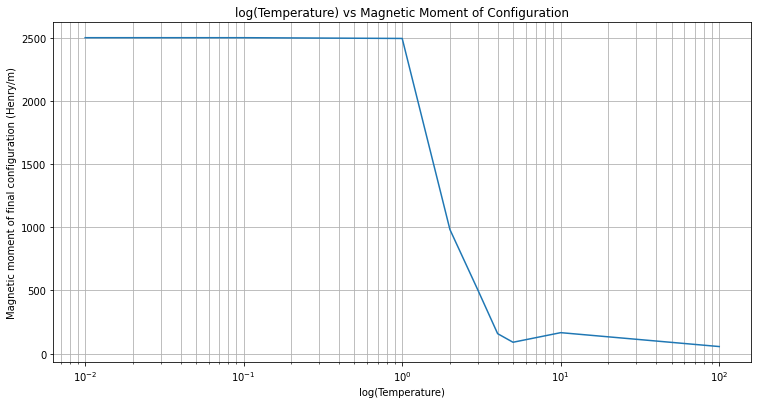

The curie temperature is approximately equal to 2


In [5]:
plt.figure(figsize=(12.5, 6.25))
plt.plot(Temperatures, maxmoments)
plt.xscale("log")  # Log scale is used for better readability
plt.grid(True, which='both')
plt.xlabel('log(Temperature)')
plt.ylabel('Magnetic moment of final configuration (Henry/m)')
plt.title('log(Temperature) vs Magnetic Moment of Configuration')
plt.show()

# Computing the change in average magnetic moment to approximate
# Curie temperature
dmaxmoments = []
for i in range(len(maxmoments)-1):
    dmaxmoments.append(maxmoments[i]-maxmoments[i+1])

# Finding the temperature at which the largest change in M occurs.
T_Cindex = dmaxmoments.index(max(dmaxmoments))
T_C = Temperatures[T_Cindex+1]
print(f'The curie temperature is approximately equal to {T_C}')

# Animations

As a bonus we now show a few animations of how the electron lattice changes over a number of steps. First we define the `animate()` function to take care of producing the individual animations.

In [6]:
def animate(temperature, frames=600, step=1000):
    """Animates the changes in a random electron configuration using
    mutate(), which is based on the Ising Model.

    Keyargs:
    temperature : The temperature to be used by mutate()
    frames      : The numbert of frames to be rendered for the animation
    step        : Number of iterations done by mutate() for each frame
                  (i.e. the number of mutations carried out for each frame)

    Returns:
    An animation showing the time-evolution of the electron spins in a
    random electron configuration.

    Note:
    animate() can only display one animation per cell.
    """
    fig = plt.figure(figsize=(7.5, 7.5))

    # Creating a random electron spin configuration
    sigma = creategrid()

    # Creating ims list to save the frames to. Saving a frame containing
    # the initial configuration
    ims = [(plt.imshow(sigma), )]

    for _ in range(frames):
        sigma = mutate(sigma, temperature, step)
        ims.append((plt.pcolormesh(sigma.copy()), ))

    # Generating the animation internally, as well as its title
    ani = animation.ArtistAnimation(fig, ims, interval=10, repeat=False)
    plt.title(f'Time evolution for an electron lattice for T={temperature}')
    plt.close()
    # The return statement will display the animation
    return HTML(ani.to_jshtml())

In [7]:
animate(0.1)  # Animation for T = 0.1

In [8]:
animate(2.5)  # Animation for T = 2.5

In [9]:
animate(100)  # Animation for T = 100

In [10]:
animate(1, frames=300, step=100000)